# How to Train YOLOv5 on Custom Objects

This tutorial is based on the [YOLOv5 repository](https://github.com/ultralytics/yolov5) by [Ultralytics](https://www.ultralytics.com/). This notebook shows training on **your own custom objects**. Many thanks to Ultralytics for putting this repository together - we hope that in combination with clean data management tools at Roboflow, this technologoy will become easily accessible to any developer wishing to use computer vision in their projects.

### Accompanying Blog Post

We recommend that you follow along in this notebook while reading the blog post on [how to train YOLOv5](https://blog.roboflow.ai/how-to-train-yolov5-on-a-custom-dataset/), concurrently.

### Steps Covered in this Tutorial

In this tutorial, we will walk through the steps required to train YOLOv5 on your custom objects. We use a [public blood cell detection dataset](https://public.roboflow.ai/object-detection/bccd), which is open source and free to use. You can also use this notebook on your own data.

To train our detector we take the following steps:

* Install YOLOv5 dependencies
* Download custom YOLOv5 object detection data
* Write our YOLOv5 Training configuration
* Run YOLOv5 training
* Evaluate YOLOv5 performance
* Visualize YOLOv5 training data
* Run YOLOv5 inference on test images
* Export saved YOLOv5 weights for future inference



### **About**

[Roboflow](https://roboflow.com) enables teams to deploy custom computer vision models quickly and accurately. Convert data from to annotation format, assess dataset health, preprocess, augment, and more. It's free for your first 1000 source images.

**Looking for a vision model available via API without hassle? Try Roboflow Train.**

![Roboflow Wordmark](https://i.imgur.com/dcLNMhV.png)



#Install Dependencies

_(Remember to choose GPU in Runtime if not already selected. Runtime --> Change Runtime Type --> Hardware accelerator --> GPU)_

In [1]:
# clone YOLOv5 repository
!git clone https://github.com/ultralytics/yolov5  # clone repo
%cd yolov5
!git reset --hard 064365d8683fd002e9ad789c1e91fa3d021b44f0

Cloning into 'yolov5'...
remote: Enumerating objects: 15368, done.
remote: Counting objects: 100% (13/13), done.
remote: Compressing objects: 100% (12/12), done.
remote: Total 15368 (delta 2), reused 9 (delta 1), pack-reused 15355
Receiving objects: 100% (15368/15368), 14.36 MiB | 23.20 MiB/s, done.
Resolving deltas: 100% (10502/10502), done.
/content/yolov5
HEAD is now at 064365d Update parse_opt() in export.py to work as in train.py (#10789)


In [2]:
# install dependencies as necessary
!pip install -qr requirements.txt  # install dependencies (ignore errors)
import torch

from IPython.display import Image, clear_output  # to display images
from utils.downloads import attempt_download  # to download models/datasets

# clear_output()
print('Setup complete. Using torch %s %s' % (torch.__version__, torch.cuda.get_device_properties(0) if torch.cuda.is_available() else 'CPU'))

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 184.3/184.3 KB 4.7 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 62.7/62.7 KB 2.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.6/1.6 MB 25.0 MB/s eta 0:00:00
Setup complete. Using torch 2.0.0+cu118 _CudaDeviceProperties(name='Tesla T4', major=7, minor=5, total_memory=15101MB, multi_processor_count=40)


# Download Correctly Formatted Custom Dataset 

We'll download our dataset from Roboflow. Use the "**YOLOv5 PyTorch**" export format. Note that the Ultralytics implementation calls for a YAML file defining where your training and test data is. The Roboflow export also writes this format for us.

To get your data into Roboflow, follow the [Getting Started Guide](https://blog.roboflow.ai/getting-started-with-roboflow/).



![YOLOv5 PyTorch export](https://i.imgur.com/5vr9G2u.png)


In [3]:
#follow the link below to get your download code from from Roboflow
#!pip install -q roboflow
#from roboflow import Roboflow
#rf = Roboflow(model_format="yolov5", notebook="roboflow-yolov5")

!pip install roboflow

from roboflow import Roboflow
rf = Roboflow(api_key="LBLyC3MJnNhkwTi9uIAR")
project = rf.workspace("null-tttt4").project("muzzle-detector")
dataset = project.version(1).download("yolov5")


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 55.7/55.7 KB 5.1 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 67.8/67.8 KB 8.9 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 58.8/58.8 KB 8.8 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 54.5/54.5 KB 7.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for wget: filename=wget-3.2-py3-none-any.whl size=9676 sha256=24b5c89ce860da88abaadeb2a9f1334f8c729f7f52199047c575f5ebeccf9731
  Stored in directory: /root/.cache/pip/wheels/04/5f/3e/46cc37c5d698415694d83f607f833f83f0149e49b3af9d0f38
Successfully built wget
  Attempting uninstall: pyparsing
    Found existing installation: pyparsing 3.0.9
    Uninstalling pyparsing-3.0.9:
      Successfully uninstalled pyparsing-3.0.9
  Attempting uninstall: idna
    Found existing installation: idna 3.4
    Uninstalling idna-3.4:
    

loading Roboflow workspace...
loading Roboflow project...


Extracting Dataset Version Zip to muzzle-detector-1 in yolov5pytorch:: 100%|██████████| 667/667 [00:00<00:00, 2151.29it/s]


In [4]:
%cd /content/yolov5
#after following the link above, recieve python code with these fields filled in
#from roboflow import Roboflow
#rf = Roboflow(api_key="YOUR API KEY HERE")
#project = rf.workspace().project("YOUR PROJECT")
#dataset = project.version("YOUR VERSION").download("yolov5")

/content/yolov5


In [5]:
# this is the YAML file Roboflow wrote for us that we're loading into this notebook with our data
%cat {dataset.location}/data.yaml

names:
- Blurry but usable
- Bullry
- Not well positioned
- Perfect
- cow-muzzle
- dirts
- not-cow-muzzle
- trash
nc: 8
roboflow:
  license: Private
  project: muzzle-detector
  url: https://app.roboflow.com/project/muzzle-detector/1
  version: 1
  workspace: project
test: ../test/images
train: muzzle-detector-1/train/images
val: muzzle-detector-1/valid/images


# Define Model Configuration and Architecture

We will write a yaml script that defines the parameters for our model like the number of classes, anchors, and each layer.

You do not need to edit these cells, but you may.

In [6]:
# define number of classes based on YAML
import yaml
with open(dataset.location + "/data.yaml", 'r') as stream:
    num_classes = str(yaml.safe_load(stream)['nc'])

In [7]:
#this is the model configuration we will use for our tutorial 
%cat /content/yolov5/models/yolov5s.yaml

# YOLOv5 🚀 by Ultralytics, GPL-3.0 license

# Parameters
nc: 80  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 v6.0 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Conv, [64, 6, 2, 2]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, C3, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 6, C3, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, C3, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 3, C3, [1024]],
   [-1, 1, SPPF, [1024, 5]],  # 9
  ]

# YOLOv5 v6.0 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, C3, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]]

In [8]:
#customize iPython writefile so we can write variables
from IPython.core.magic import register_line_cell_magic

@register_line_cell_magic
def writetemplate(line, cell):
    with open(line, 'w') as f:
        f.write(cell.format(**globals()))

In [9]:
%%writetemplate /content/yolov5/models/custom_yolov5s.yaml

# parameters
nc: {num_classes}  # number of classes
depth_multiple: 0.33  # model depth multiple
width_multiple: 0.50  # layer channel multiple

# anchors
anchors:
  - [10,13, 16,30, 33,23]  # P3/8
  - [30,61, 62,45, 59,119]  # P4/16
  - [116,90, 156,198, 373,326]  # P5/32

# YOLOv5 backbone
backbone:
  # [from, number, module, args]
  [[-1, 1, Focus, [64, 3]],  # 0-P1/2
   [-1, 1, Conv, [128, 3, 2]],  # 1-P2/4
   [-1, 3, BottleneckCSP, [128]],
   [-1, 1, Conv, [256, 3, 2]],  # 3-P3/8
   [-1, 9, BottleneckCSP, [256]],
   [-1, 1, Conv, [512, 3, 2]],  # 5-P4/16
   [-1, 9, BottleneckCSP, [512]],
   [-1, 1, Conv, [1024, 3, 2]],  # 7-P5/32
   [-1, 1, SPP, [1024, [5, 9, 13]]],
   [-1, 3, BottleneckCSP, [1024, False]],  # 9
  ]

# YOLOv5 head
head:
  [[-1, 1, Conv, [512, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 6], 1, Concat, [1]],  # cat backbone P4
   [-1, 3, BottleneckCSP, [512, False]],  # 13

   [-1, 1, Conv, [256, 1, 1]],
   [-1, 1, nn.Upsample, [None, 2, 'nearest']],
   [[-1, 4], 1, Concat, [1]],  # cat backbone P3
   [-1, 3, BottleneckCSP, [256, False]],  # 17 (P3/8-small)

   [-1, 1, Conv, [256, 3, 2]],
   [[-1, 14], 1, Concat, [1]],  # cat head P4
   [-1, 3, BottleneckCSP, [512, False]],  # 20 (P4/16-medium)

   [-1, 1, Conv, [512, 3, 2]],
   [[-1, 10], 1, Concat, [1]],  # cat head P5
   [-1, 3, BottleneckCSP, [1024, False]],  # 23 (P5/32-large)

   [[17, 20, 23], 1, Detect, [nc, anchors]],  # Detect(P3, P4, P5)
  ]

# Train Custom YOLOv5 Detector

### Next, we'll fire off training!


Here, we are able to pass a number of arguments:
- **img:** define input image size
- **batch:** determine batch size
- **epochs:** define the number of training epochs. (Note: often, 3000+ are common here!)
- **data:** set the path to our yaml file
- **cfg:** specify our model configuration
- **weights:** specify a custom path to weights. (Note: you can download weights from the Ultralytics Google Drive [folder](https://drive.google.com/open?id=1Drs_Aiu7xx6S-ix95f9kNsA6ueKRpN2J))
- **name:** result names
- **nosave:** only save the final checkpoint
- **cache:** cache images for faster training

In [10]:
# train yolov5s on custom data for 100 epochs
# time its performance
%%time
%cd /content/yolov5/
!python train.py --img 416 --batch 16 --epochs 100 --data {dataset.location}/data.yaml --cfg ./models/custom_yolov5s.yaml --weights '' --name yolov5s_results  --cache

/content/yolov5
2023-04-05 23:02:19.978299: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-04-05 23:02:20.900219: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
train: weights=, cfg=./models/custom_yolov5s.yaml, data=/content/yolov5/muzzle-detector-1/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=yolov5s_results, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-

# Evaluate Custom YOLOv5 Detector Performance

Training losses and performance metrics are saved to Tensorboard and also to a logfile defined above with the **--name** flag when we train. In our case, we named this `yolov5s_results`. (If given no name, it defaults to `results.txt`.) The results file is plotted as a png after training completes.

Note from Glenn: Partially completed `results.txt` files can be plotted with `from utils.utils import plot_results; plot_results()`.

In [11]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

<IPython.core.display.Javascript object>

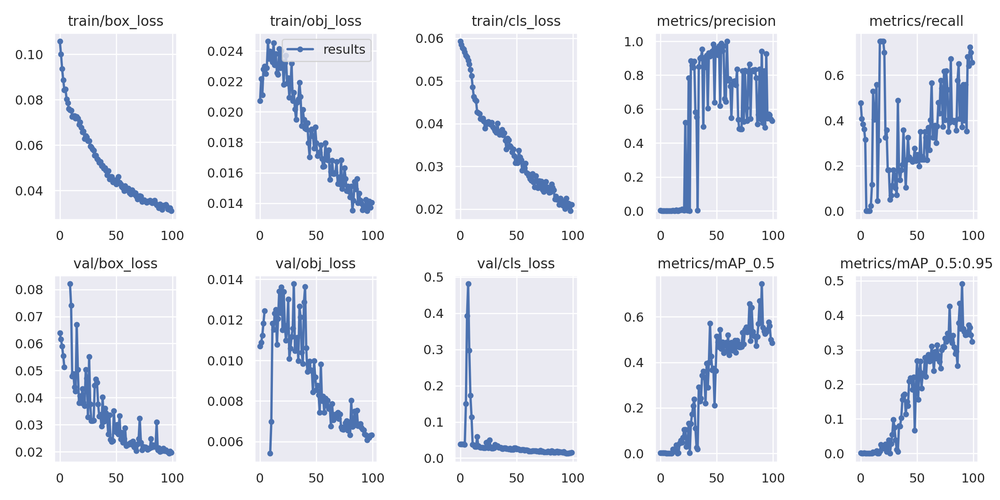

In [12]:
# we can also output some older school graphs if the tensor board isn't working for whatever reason... 
from utils.plots import plot_results  # plot results.txt as results.png
Image(filename='/content/yolov5/runs/train/yolov5s_results/results.png', width=1000)  # view results.png

In [16]:
!python benchmarks.py --weights /content/yolov5/runs/train/yolov5s_results/weights/best.pt --imgsz 640 --device 0

benchmarks: weights=/content/yolov5/runs/train/yolov5s_results/weights/best.pt, imgsz=640, batch_size=1, data=/content/yolov5/data/coco128.yaml, device=0, half=False, test=False, pt_only=False, hard_fail=False
YOLOv5 🚀 v7.0-72-g064365d Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

YOLOv5 🚀 v7.0-72-g064365d Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 182 layers, 7265397 parameters, 0 gradients
WARNING ⚠️ Benchmark failure for PyTorch: /content/yolov5/runs/train/yolov5s_results/weights/best.pt (8 classes) trained on different --data than what you passed (80 classes). Pass correct combination of --weights and --data that are trained together.
YOLOv5 🚀 v7.0-72-g064365d Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 182 layers, 7265397 parameters, 0 gradients

PyTorch: starting from /content/yolov5/runs/train/yolov5s_results/weights/best.pt with output shape (1, 

In [24]:
!python export.py --weights /content/yolov5/runs/train/yolov5s_results/weights/best.pt --include torchscript tflite

export: data=data/coco128.yaml, weights=['/content/yolov5/runs/train/yolov5s_results/weights/best.pt'], imgsz=[640, 640], batch_size=1, device=cpu, half=False, inplace=False, keras=False, optimize=False, int8=False, dynamic=False, simplify=False, opset=17, verbose=False, workspace=4, nms=False, agnostic_nms=False, topk_per_class=100, topk_all=100, iou_thres=0.45, conf_thres=0.25, include=['torchscript', 'tflite']
YOLOv5 🚀 v7.0-72-g064365d Python-3.9.16 torch-2.0.0+cu118 CPU

Fusing layers... 
custom_YOLOv5s summary: 182 layers, 7265397 parameters, 0 gradients

PyTorch: starting from /content/yolov5/runs/train/yolov5s_results/weights/best.pt with output shape (1, 25200, 13) (14.1 MB)

TorchScript: starting export with torch 2.0.0+cu118...
TorchScript: export success ✅ 3.2s, saved as /content/yolov5/runs/train/yolov5s_results/weights/best.torchscript (28.2 MB)
2023-04-05 23:40:07.763841: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use avail

In [17]:
!python detect.py --weights yolov5s-fp16.tflite --img 640 --conf 0.25 --source /content/yolov5/muzzle-detector-1/test/images/20221003_112332_jpg.rf.e729bbbb58e26b53bb2f507a0fb749d0.jpg

detect: weights=['yolov5s-fp16.tflite'], source=/content/yolov5/muzzle-detector-1/test/images/20221003_112332_jpg.rf.e729bbbb58e26b53bb2f507a0fb749d0.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-72-g064365d Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

2023-04-05 23:34:34.410240: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-04-05 23:34:35.568557: W tensorflow/compiler/t

In [21]:
!python detect.py --weights /content/yolov5/runs/train/yolov5s_results/weights/best.pt --img 640 --conf 0.25 --source /content/yolov5/muzzle-detector-1/test/images/20221003_112332_jpg.rf.e729bbbb58e26b53bb2f507a0fb749d0.jpg

detect: weights=['/content/yolov5/runs/train/yolov5s_results/weights/best.pt'], source=/content/yolov5/muzzle-detector-1/test/images/20221003_112332_jpg.rf.e729bbbb58e26b53bb2f507a0fb749d0.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-72-g064365d Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 182 layers, 7265397 parameters, 0 gradients
image 1/1 /content/yolov5/muzzle-detector-1/test/images/20221003_112332_jpg.rf.e729bbbb58e26b53bb2f507a0fb749d0.jpg: 640x640 2 cow-muzzles, 12.5ms
Speed: 0.6ms pre-process, 12.5ms inference, 82.9ms NMS per image at shape (1, 3, 640, 640)


In [22]:
!python detect.py --weights /content/yolov5/runs/train/yolov5s_results/weights/best.pt --img 640 --conf 0.25 --source /content/yolov5/muzzle-detector-1/valid/images/20221003_113329_jpg.rf.96eed4c62651c602d8495eac05670a77.jpg

detect: weights=['/content/yolov5/runs/train/yolov5s_results/weights/best.pt'], source=/content/yolov5/muzzle-detector-1/valid/images/20221003_113329_jpg.rf.96eed4c62651c602d8495eac05670a77.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-72-g064365d Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 182 layers, 7265397 parameters, 0 gradients
image 1/1 /content/yolov5/muzzle-detector-1/valid/images/20221003_113329_jpg.rf.96eed4c62651c602d8495eac05670a77.jpg: 640x640 (no detections), 12.6ms
Speed: 0.7ms pre-process, 12.6ms inference, 17.8ms NMS per image at shape (1, 3, 640, 6

In [23]:
!python detect.py --weights /content/yolov5/runs/train/yolov5s_results/weights/best.pt --img 640 --conf 0.25 --source /content/yolov5/muzzle-detector-1/test/images/IMG_20220928_122425_jpg.rf.cc1c9393011d64e8b3071bc8125e5687.jpg

detect: weights=['/content/yolov5/runs/train/yolov5s_results/weights/best.pt'], source=/content/yolov5/muzzle-detector-1/test/images/IMG_20220928_122425_jpg.rf.cc1c9393011d64e8b3071bc8125e5687.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-72-g064365d Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 182 layers, 7265397 parameters, 0 gradients
image 1/1 /content/yolov5/muzzle-detector-1/test/images/IMG_20220928_122425_jpg.rf.cc1c9393011d64e8b3071bc8125e5687.jpg: 640x640 3 cow-muzzles, 12.5ms
Speed: 0.6ms pre-process, 12.5ms inference, 77.5ms NMS per image at shape (1, 3, 64

In [25]:
!python detect.py --weights /content/yolov5/runs/train/yolov5s_results/weights/best-fp16.tflite --img 640 --conf 0.25 --source /content/yolov5/muzzle-detector-1/test/images/IMG_20220928_122425_jpg.rf.cc1c9393011d64e8b3071bc8125e5687.jpg

detect: weights=['/content/yolov5/runs/train/yolov5s_results/weights/best-fp16.tflite'], source=/content/yolov5/muzzle-detector-1/test/images/IMG_20220928_122425_jpg.rf.cc1c9393011d64e8b3071bc8125e5687.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-72-g064365d Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

2023-04-05 23:42:24.864124: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.

In [26]:
!python train.py --img 416 --batch 16 --epochs 500 --data {dataset.location}/data.yaml --cfg ./models/custom_yolov5s.yaml --weights '' --name yolov5s_results  --cache

2023-04-05 23:44:21.953550: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-04-05 23:44:22.987384: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Could not find TensorRT
train: weights=, cfg=./models/custom_yolov5s.yaml, data=/content/yolov5/muzzle-detector-1/data.yaml, hyp=data/hyps/hyp.scratch-low.yaml, epochs=500, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=ram, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=8, project=runs/train, name=yolov5s_results, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local

In [27]:
# Start tensorboard
# Launch after you have started training
# logs save in the folder "runs"
%load_ext tensorboard
%tensorboard --logdir runs

The tensorboard extension is already loaded. To reload it, use:
  %reload_ext tensorboard


Reusing TensorBoard on port 6006 (pid 3020), started 0:59:46 ago. (Use '!kill 3020' to kill it.)

<IPython.core.display.Javascript object>

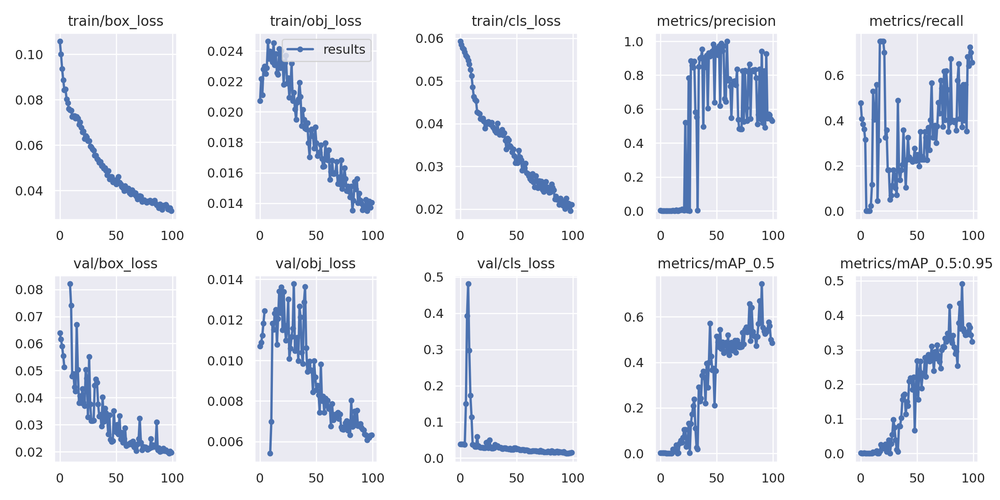

In [28]:
# we can also output some older school graphs if the tensor board isn't working for whatever reason... 
from utils.plots import plot_results  # plot results.txt as results.png
Image(filename='/content/yolov5/runs/train/yolov5s_results2/results.png', width=1000)  # view results.png

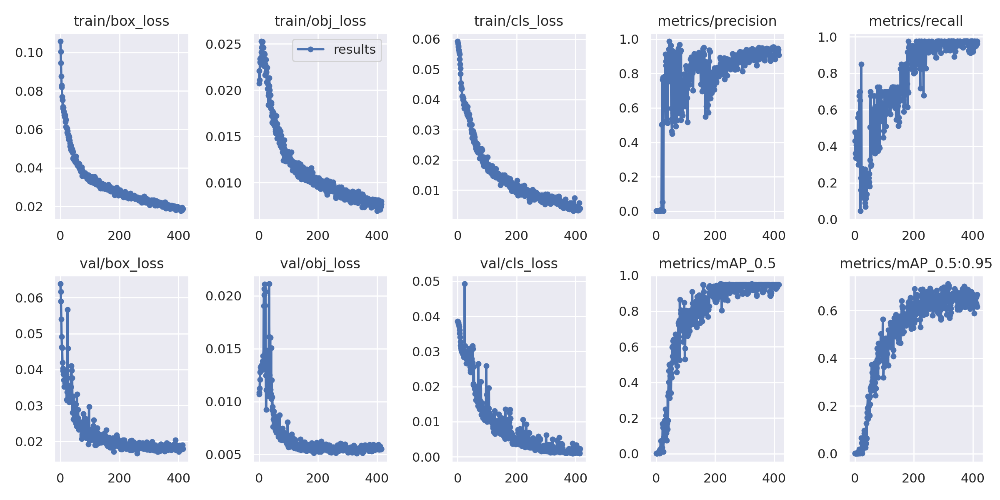

In [29]:
Image(filename='/content/yolov5/runs/train/yolov5s_results2/results.png', width=1000)  # view results.png

In [30]:
!python benchmarks.py --weights /content/yolov5/runs/train/yolov5s_results2/weights/best.pt --imgsz 640 --device 0

benchmarks: weights=/content/yolov5/runs/train/yolov5s_results2/weights/best.pt, imgsz=640, batch_size=1, data=/content/yolov5/data/coco128.yaml, device=0, half=False, test=False, pt_only=False, hard_fail=False
YOLOv5 🚀 v7.0-72-g064365d Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

YOLOv5 🚀 v7.0-72-g064365d Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 182 layers, 7265397 parameters, 0 gradients
WARNING ⚠️ Benchmark failure for PyTorch: /content/yolov5/runs/train/yolov5s_results2/weights/best.pt (8 classes) trained on different --data than what you passed (80 classes). Pass correct combination of --weights and --data that are trained together.
YOLOv5 🚀 v7.0-72-g064365d Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 182 layers, 7265397 parameters, 0 gradients

PyTorch: starting from /content/yolov5/runs/train/yolov5s_results2/weights/best.pt with output shape (

In [31]:
!python export.py --weights /content/yolov5/runs/train/yolov5s_results2/weights/best.pt --include tflite

export: data=data/coco128.yaml, weights=['/content/yolov5/runs/train/yolov5s_results2/weights/best.pt'], imgsz=[640, 640], batch_size=1, device=cpu, half=False, inplace=False, keras=False, optimize=False, int8=False, dynamic=False, simplify=False, opset=17, verbose=False, workspace=4, nms=False, agnostic_nms=False, topk_per_class=100, topk_all=100, iou_thres=0.45, conf_thres=0.25, include=['tflite']
YOLOv5 🚀 v7.0-72-g064365d Python-3.9.16 torch-2.0.0+cu118 CPU

Fusing layers... 
custom_YOLOv5s summary: 182 layers, 7265397 parameters, 0 gradients

PyTorch: starting from /content/yolov5/runs/train/yolov5s_results2/weights/best.pt with output shape (1, 25200, 13) (14.1 MB)
2023-04-06 00:10:57.924678: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2023-04-0

In [32]:
!python detect.py --weights /content/yolov5/runs/train/yolov5s_results2/weights/best-fp16.tflite --img 640 --conf 0.25 --source /content/yolov5/muzzle-detector-1/test/images/IMG_20220928_122425_jpg.rf.cc1c9393011d64e8b3071bc8125e5687.jpg

detect: weights=['/content/yolov5/runs/train/yolov5s_results2/weights/best-fp16.tflite'], source=/content/yolov5/muzzle-detector-1/test/images/IMG_20220928_122425_jpg.rf.cc1c9393011d64e8b3071bc8125e5687.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-72-g064365d Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

2023-04-06 00:20:02.385820: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags

In [33]:
!python detect.py --weights /content/yolov5/runs/train/yolov5s_results2/weights/best.pt --img 640 --conf 0.25 --source /content/yolov5/muzzle-detector-1/test/images/IMG_20220928_122425_jpg.rf.cc1c9393011d64e8b3071bc8125e5687.jpg

detect: weights=['/content/yolov5/runs/train/yolov5s_results2/weights/best.pt'], source=/content/yolov5/muzzle-detector-1/test/images/IMG_20220928_122425_jpg.rf.cc1c9393011d64e8b3071bc8125e5687.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-72-g064365d Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 182 layers, 7265397 parameters, 0 gradients
image 1/1 /content/yolov5/muzzle-detector-1/test/images/IMG_20220928_122425_jpg.rf.cc1c9393011d64e8b3071bc8125e5687.jpg: 640x640 2 dirtss, 12.6ms
Speed: 0.7ms pre-process, 12.6ms inference, 138.6ms NMS per image at shape (1, 3, 640, 

In [34]:
!python detect.py --weights /content/yolov5/runs/train/yolov5s_results2/weights/best.pt --img 640 --conf 0.25 --source /content/yolov5/muzzle-detector-1/valid/images/20220929_114206_jpg.rf.45b2782698d0835dcd591d26a0542475.jpg

detect: weights=['/content/yolov5/runs/train/yolov5s_results2/weights/best.pt'], source=/content/yolov5/muzzle-detector-1/valid/images/20220929_114206_jpg.rf.45b2782698d0835dcd591d26a0542475.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-72-g064365d Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 182 layers, 7265397 parameters, 0 gradients
image 1/1 /content/yolov5/muzzle-detector-1/valid/images/20220929_114206_jpg.rf.45b2782698d0835dcd591d26a0542475.jpg: 640x640 1 Perfect, 12.5ms
Speed: 0.6ms pre-process, 12.5ms inference, 93.9ms NMS per image at shape (1, 3, 640, 640)
R

In [35]:
!python detect.py --weights /content/yolov5/runs/train/yolov5s_results2/weights/best.pt --img 640 --conf 0.25 --source /content/yolov5/muzzle-detector-1/test/images/20221003_113350_jpg.rf.5dfefa26d58d1e802bb7396a89778b32.jpg

detect: weights=['/content/yolov5/runs/train/yolov5s_results2/weights/best.pt'], source=/content/yolov5/muzzle-detector-1/test/images/20221003_113350_jpg.rf.5dfefa26d58d1e802bb7396a89778b32.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-72-g064365d Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 182 layers, 7265397 parameters, 0 gradients
image 1/1 /content/yolov5/muzzle-detector-1/test/images/20221003_113350_jpg.rf.5dfefa26d58d1e802bb7396a89778b32.jpg: 640x640 1 Bullry, 12.6ms
Speed: 0.6ms pre-process, 12.6ms inference, 115.6ms NMS per image at shape (1, 3, 640, 640)
Res

In [36]:
!python detect.py --weights /content/yolov5/runs/train/yolov5s_results2/weights/best.pt --img 640 --conf 0.25 --source /content/yolov5/muzzle-detector-1/test/images/IMG_20220928_125801_jpg.rf.25949faf5b6a6d1a5eb5fe0d092d30ad.jpg

detect: weights=['/content/yolov5/runs/train/yolov5s_results2/weights/best.pt'], source=/content/yolov5/muzzle-detector-1/test/images/IMG_20220928_125801_jpg.rf.25949faf5b6a6d1a5eb5fe0d092d30ad.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-72-g064365d Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 182 layers, 7265397 parameters, 0 gradients
image 1/1 /content/yolov5/muzzle-detector-1/test/images/IMG_20220928_125801_jpg.rf.25949faf5b6a6d1a5eb5fe0d092d30ad.jpg: 640x640 1 Not well positioned, 12.6ms
Speed: 0.7ms pre-process, 12.6ms inference, 105.3ms NMS per image at shape

In [37]:
!python detect.py --weights /content/yolov5/runs/train/yolov5s_results2/weights/best.pt --img 640 --conf 0.25 --source /content/yolov5/muzzle-detector-1/test/images/20221003_112332_jpg.rf.e729bbbb58e26b53bb2f507a0fb749d0.jpg

detect: weights=['/content/yolov5/runs/train/yolov5s_results2/weights/best.pt'], source=/content/yolov5/muzzle-detector-1/test/images/20221003_112332_jpg.rf.e729bbbb58e26b53bb2f507a0fb749d0.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-72-g064365d Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Fusing layers... 
custom_YOLOv5s summary: 182 layers, 7265397 parameters, 0 gradients
image 1/1 /content/yolov5/muzzle-detector-1/test/images/20221003_112332_jpg.rf.e729bbbb58e26b53bb2f507a0fb749d0.jpg: 640x640 1 cow-muzzle, 12.5ms
Speed: 0.6ms pre-process, 12.5ms inference, 82.1ms NMS per image at shape (1, 3, 640, 640)


In [38]:
!python detect.py --weights /content/yolov5/runs/train/yolov5s_results2/weights/best.engine --img 640 --conf 0.25 --source /content/yolov5/muzzle-detector-1/test/images/20221003_112332_jpg.rf.e729bbbb58e26b53bb2f507a0fb749d0.jpg

detect: weights=['/content/yolov5/runs/train/yolov5s_results2/weights/best.engine'], source=/content/yolov5/muzzle-detector-1/test/images/20221003_112332_jpg.rf.e729bbbb58e26b53bb2f507a0fb749d0.jpg, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v7.0-72-g064365d Python-3.9.16 torch-2.0.0+cu118 CUDA:0 (Tesla T4, 15102MiB)

Loading /content/yolov5/runs/train/yolov5s_results2/weights/best.engine for TensorRT inference...
[04/06/2023-00:28:54] [TRT] [I] [MemUsageChange] Init CUDA: CPU +317, GPU +0, now: CPU 442, GPU 239 (MiB)
[04/06/2023-00:28:54] [TRT] [I] Loaded engine size: 30 MiB
[04/06/2023-00:28:54] [TRT] [I] [MemUsageChange] Init cu

In [40]:
!cp -R /content/yolov5/runs /content/drive/MyDrive

In [39]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### Curious? Visualize Our Training Data with Labels

After training starts, view `train*.jpg` images to see training images, labels and augmentation effects.

Note a mosaic dataloader is used for training (shown below), a new dataloading concept developed by Glenn Jocher and first featured in [YOLOv4](https://arxiv.org/abs/2004.10934).

GROUND TRUTH TRAINING DATA:


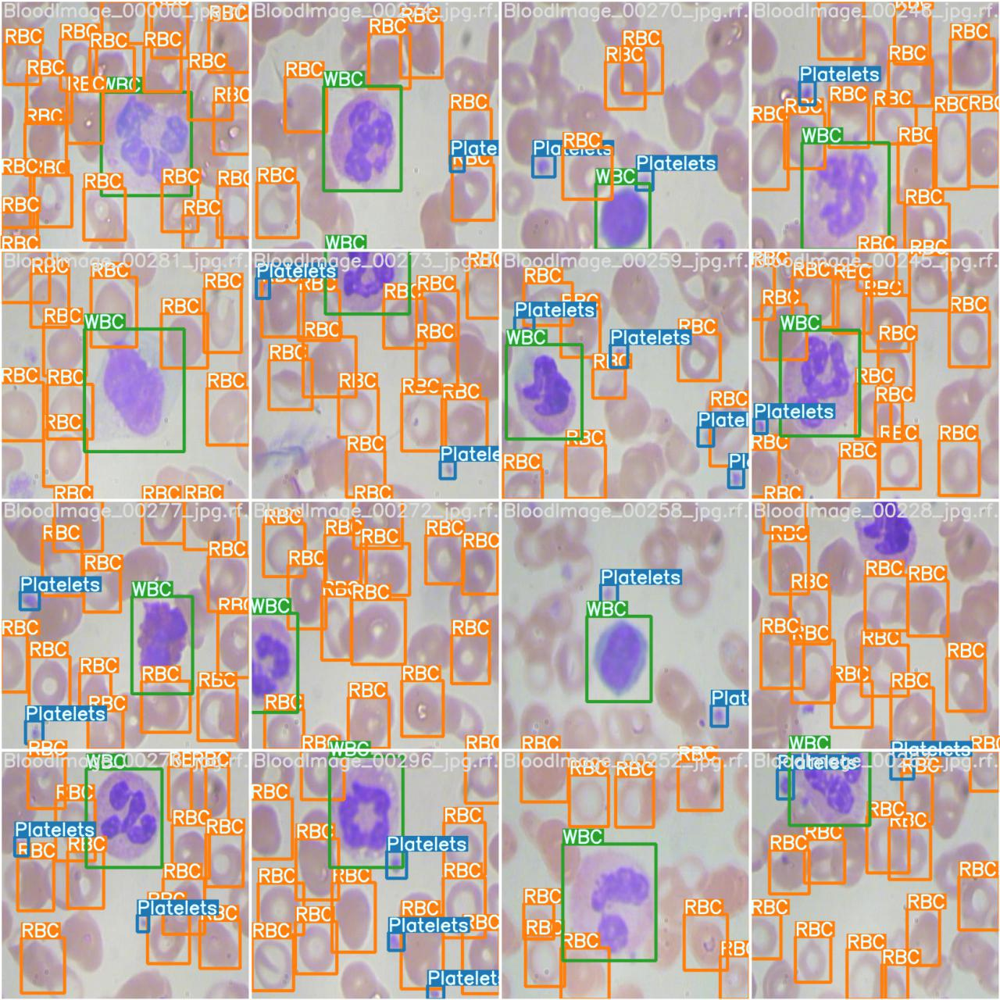

In [ ]:
# first, display our ground truth data
print("GROUND TRUTH TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/yolov5s_results/test_batch0_labels.jpg', width=900)

GROUND TRUTH AUGMENTED TRAINING DATA:


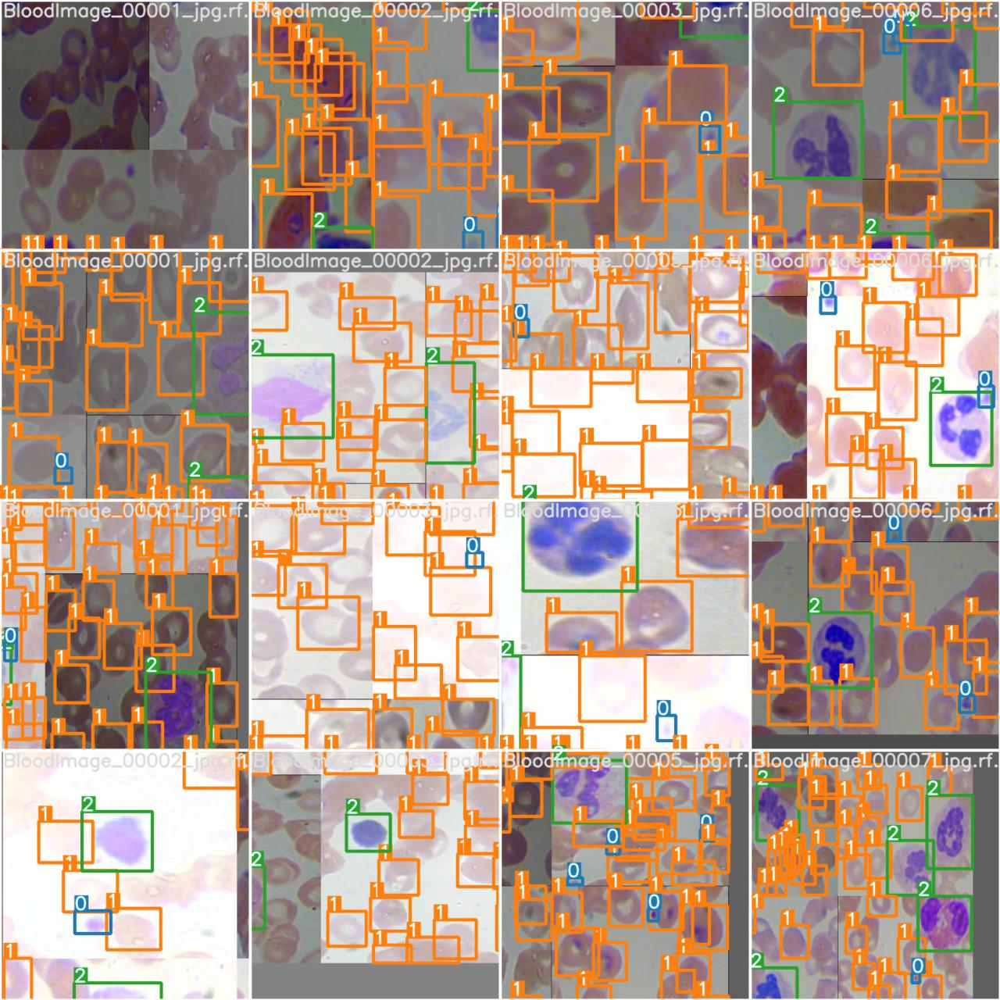

In [ ]:
# print out an augmented training example
print("GROUND TRUTH AUGMENTED TRAINING DATA:")
Image(filename='/content/yolov5/runs/train/yolov5s_results/train_batch0.jpg', width=900)

#Run Inference  With Trained Weights
Run inference with a pretrained checkpoint on contents of `test/images` folder downloaded from Roboflow.

In [ ]:
# trained weights are saved by default in our weights folder
%ls runs/

train/


In [ ]:
%ls runs/train/yolov5s_results/weights

best.pt  last.pt


In [ ]:
# when we ran this, we saw .007 second inference time. That is 140 FPS on a TESLA P100!
# use the best weights!
%cd /content/yolov5/
!python detect.py --weights runs/train/yolov5s_results/weights/best.pt --img 416 --conf 0.4 --source ../test/images

/content/yolov5
Namespace(agnostic_nms=False, augment=False, classes=None, conf_thres=0.4, device='', exist_ok=False, img_size=416, iou_thres=0.45, name='exp', project='runs/detect', save_conf=False, save_txt=False, source='../test/images', update=False, view_img=False, weights=['runs/train/yolov5s_results/weights/best.pt'])
Using torch 1.7.1+cu101 CPU

Fusing layers... 
Model Summary: 232 layers, 7251912 parameters, 0 gradients
image 1/36 /content/test/images/BloodImage_00038_jpg.rf.ffa23e4b5b55b523367f332af726eae8.jpg: 416x416 Done. (0.204s)
image 2/36 /content/test/images/BloodImage_00044_jpg.rf.e7760375eba4bc20c5746367e2311e18.jpg: 416x416 Done. (0.171s)
image 3/36 /content/test/images/BloodImage_00062_jpg.rf.1be1ca0ecdf783798fc10346baaa203e.jpg: 416x416 Done. (0.173s)
image 4/36 /content/test/images/BloodImage_00090_jpg.rf.cdbf8f6ed3b93fa902a0bc991132cb40.jpg: 416x416 Done. (0.163s)
image 5/36 /content/test/images/BloodImage_00099_jpg.rf.e3c42cd68359527494a53843479dff5c.jpg: 416x4

In [ ]:
#display inference on ALL test images
#this looks much better with longer training above

import glob
from IPython.display import Image, display

for imageName in glob.glob('/content/yolov5/runs/detect/exp/*.jpg'): #assuming JPG
    display(Image(filename=imageName))
    print("\n")

# Deploy Model Weights to Roboflow

Now that you have trained your custom detector, you can upload it to Roboflow to deploy you model to a Hosted API and edge containers.

In [ ]:
project.version(dataset.version).deploy(model_type="yolov5", model_path=f"/content/yolov5/runs/train/yolov5s_results/")

In [ ]:
#While your deployment is processing, checkout the deployment docs to take your model to most destinations https://docs.roboflow.com/inference

In [ ]:
#Run inference on your model on a persistant, auto-scaling, cloud API

#load model
model = project.version(dataset.version).model

#choose random test set image
import os, random
test_set_loc = dataset.location + "/test/images/"
random_test_image = random.choice(os.listdir(test_set_loc))
print("running inference on " + random_test_image)

pred = model.predict(test_set_loc + random_test_image, confidence=40, overlap=30).json()
pred

## Congrats!

Hope you enjoyed this!

--Team [Roboflow](https://roboflow.ai)